In [18]:
import os
import torch
import warnings
warnings.simplefilter('ignore')
import numpy as np
import torchvision
import torch.nn as nn
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, Dataset, WeightedRandomSampler
import matplotlib.pyplot as plt
import torch.optim as optim
import torch.nn.functional as F
import torchvision.models as models

import imgaug as ia
import imgaug.augmenters as iaa
from collections import Counter

In [19]:
TRAIN_DIR = './images/input/train/'
BATCH_SIZE = 128

In [31]:
class CropDataset(Dataset):
    def __init__(self, file_path, transform=None, augment=False):
        xform = transforms.Compose([transforms.ToTensor()]) if transform is None else transform
        self.img_dataset = datasets.ImageFolder(file_path, transform=xform)
        self.aug = augment
        
        ## augumentation initialization
        ia.seed(241)

        self.seq = iaa.Sequential([
            iaa.Fliplr(0.5), # horizontal flips
            iaa.Crop(percent=(0, 0.1)), # random crops
            # Small gaussian blur with random sigma between 0 and 0.5.
            # But we only blur about 50% of all images.
            iaa.Sometimes(
                0.5,
                iaa.GaussianBlur(sigma=(0, 0.5))
            ),
            # Strengthen or weaken the contrast in each image.
            iaa.LinearContrast((0.75, 1.5)),
            # Add gaussian noise.
            # For 50% of all images, we sample the noise once per pixel.
            # For the other 50% of all images, we sample the noise per pixel AND
            # channel. This can change the color (not only brightness) of the
            # pixels.
            iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.05*255), per_channel=0.5),
            # Make some images brighter and some darker.
            # In 20% of all cases, we sample the multiplier once per channel,
            # which can end up changing the color of the images.
            iaa.Multiply((0.8, 1.2), per_channel=0.2),
            # Apply affine transformations to each image.
            # Scale/zoom them, translate/move them, rotate them and shear them.
            iaa.Affine(
                scale={"x": (0.8, 1.2), "y": (0.8, 1.2)},
                translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)},
                rotate=(-25, 25),
                shear=(-8, 8)
            )
        ], random_order=True) # apply augmenters in random order

    def __len__(self):
        return len(self.img_dataset)

    def __getitem__(self, idx):
        image, label = self.img_dataset[idx]
        return image, label
    
    # this is an experimental method created to explore how the dunder methods can be modified
    def __repr__(self, idx=0):
        image, label = self.img_dataset[idx]
        plt.imshow(image.permute(1,2,0))
        return str("Display view of the image")
    
    def collate_fn(self, batch):
        images, targets = list(zip(*batch))
        images = torch.stack(images).permute(0 , 2, 3, 1)
        if self.aug: images=self.seq.augment_images(images=images.numpy()) 
        targets = torch.tensor(targets)
        images = torch.tensor(images).permute(0, 3, 1, 2)
        if torch.cuda.is_available():
            targets = targets.to(device)
            images = images.to(device)
        return images, targets

In [32]:
# Here we create our final transformation that would be used before we send the data for training the model
transform = torchvision.transforms.Compose([transforms.ToTensor(),
                                            transforms.Normalize((0.4743617, 0.49847862, 0.4265874 ),
                                                                 (0.21134755, 0.19044809, 0.22679578))]
                                          )
crop_dataset = CropDataset(TRAIN_DIR, transform, True)
print(crop_dataset.img_dataset.class_to_idx)

{'Apple___Apple_scab': 0, 'Apple___Black_rot': 1, 'Apple___Cedar_apple_rust': 2, 'Apple___healthy': 3, 'Blueberry___healthy': 4, 'Cherry_(including_sour)___Powdery_mildew': 5, 'Cherry_(including_sour)___healthy': 6, 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot': 7, 'Corn_(maize)___Common_rust_': 8, 'Corn_(maize)___Northern_Leaf_Blight': 9, 'Corn_(maize)___healthy': 10, 'Grape___Black_rot': 11, 'Grape___Esca_(Black_Measles)': 12, 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 13, 'Grape___healthy': 14, 'Peach___Bacterial_spot': 15, 'Peach___healthy': 16, 'Pepper,_bell___Bacterial_spot': 17, 'Pepper,_bell___healthy': 18, 'Potato___Early_blight': 19, 'Potato___Late_blight': 20, 'Potato___healthy': 21, 'Strawberry___Leaf_scorch': 22, 'Strawberry___healthy': 23, 'Tomato___Bacterial_spot': 24, 'Tomato___Early_blight': 25, 'Tomato___Late_blight': 26, 'Tomato___Leaf_Mold': 27, 'Tomato___Septoria_leaf_spot': 28, 'Tomato___Spider_mites Two-spotted_spider_mite': 29, 'Tomato___Target_Spot': 

In [36]:
crop_loader = DataLoader(dataset=crop_dataset.img_dataset, 
                         batch_size=BATCH_SIZE, 
                         shuffle=True,) 
                         #collate_fn=crop_dataset.collate_fn)

In [37]:
feature, label = iter(crop_loader).next()
fig, axes = plt.subplots(figsize=(200,100), nrows=16, ncols=8)
for i in range(16):
    for j in range(8):
        x = feature[(8*i)+j]
        x -= x.min(1, keepdim=True)[0] 
        x /= x.max(1, keepdim=True)[0]
        ax = axes[i][j]
        ax.imshow(x.permute(1, 2, 0))
        ax.title.set_text(' '.join('%5s' % os.path.basename(crop_dataset.img_dataset.imgs[(8*i)+j][0])))

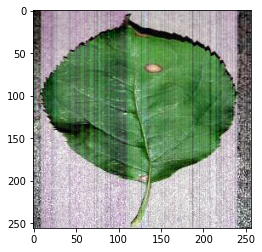

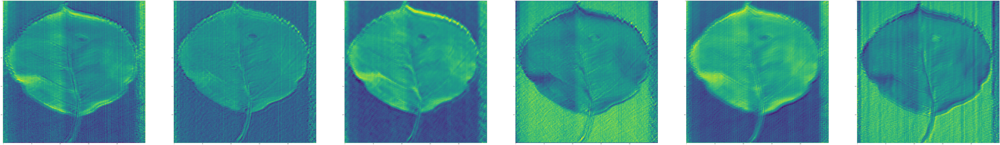

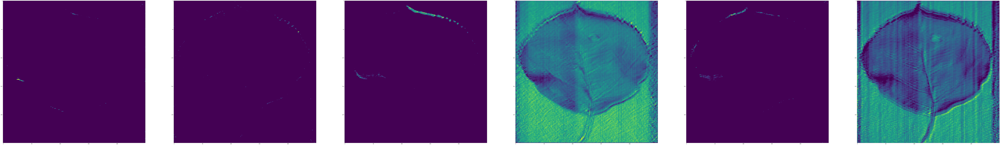

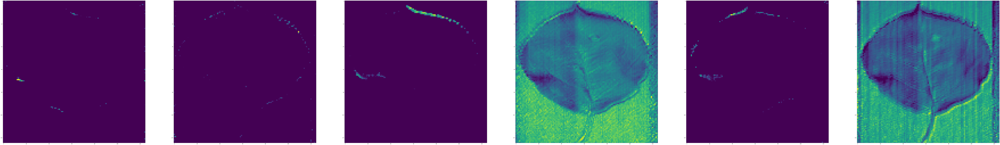

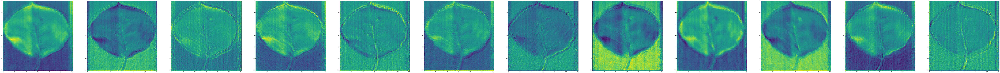

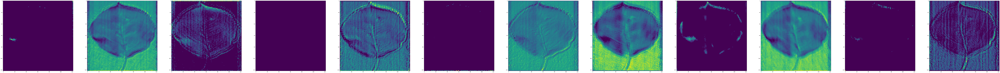

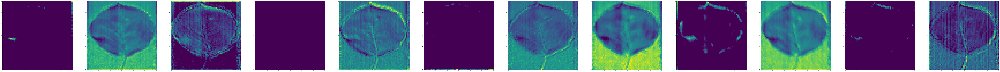

In [38]:
# Here we look at a single image. Our intent is to see how does an image transform through the convolution model that 
# we are proposing
img_one_feature = feature[:1]
img_one_label = label[:1]
img_one_feature.shape, img_one_label.shape

plt.imshow(img_one_feature[0].permute(1,2,0))

# We define a convolution that converts the RGB channel into 6 features/filters/channels using a kernel size of 3 
# a stride of 1 and padding of 1. On this we would apply pooling of 2*2
cnv1 = nn.Conv2d(3, 6, kernel_size=9, padding=1, stride=1)
#print(cnv1.weight, cnv1.bias)
layer1 = cnv1(img_one_feature)
fig, axes = plt.subplots(figsize=(200,100), ncols=6)
for i in range(6):
    x = torch.tensor(layer1[0,i:i+1,:], requires_grad=False)
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))

layer1 = F.relu(layer1)
fig, axes = plt.subplots(figsize=(200,100), ncols=6)
for i in range(6):
    x = torch.tensor(layer1[0,i:i+1,:], requires_grad=False)
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))

pool = nn.MaxPool2d(2, 2)    
layer1 = pool(layer1)
fig, axes = plt.subplots(figsize=(200,100), ncols=6)
for i in range(6):
    x = torch.tensor(layer1[0,i:i+1,:], requires_grad=False)
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))
print()


# We define a convolution that converts the RGB channel into 12 features/filters/channels using a kernel size of 3 
# a stride of 1 and padding of 1. On this we would apply pooling of 2*2
cnv2 = nn.Conv2d(6, 12, kernel_size=6, padding=1, stride=1)
#print(cnv2.weight, cnv1.bias)
layer2 = cnv2(layer1)
fig, axes = plt.subplots(figsize=(200,100), ncols=12)
for i in range(12):
    x = torch.tensor(layer2[0,i:i+1,:], requires_grad=False)
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))

layer2 = F.relu(layer2)
fig, axes = plt.subplots(figsize=(200,100), ncols=12)
for i in range(12):
    x = torch.tensor(layer2[0,i:i+1,:], requires_grad=False)
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))

pool = nn.MaxPool2d(2, 2)    
layer2 = pool(layer2)
fig, axes = plt.subplots(figsize=(200,100), ncols=12)
for i in range(12):
    x = torch.tensor(layer2[0,i:i+1,:], requires_grad=False)
    ax = axes[i]
    ax.imshow(x.permute(1, 2, 0))
print()


# We define a convolution that converts the RGB channel into 12 features/filters/channels using a kernel size of 3 
# a stride of 1 and padding of 1. On this we would apply pooling of 2*2
cnv3 = nn.Conv2d(12, 36, kernel_size=3, padding=1, stride=1)
#print(cnv3.weight, cnv1.bias)
layer3 = cnv3(layer2)
fig, axes = plt.subplots(figsize=(200,100), ncols=12, nrows=3)
for i in range(3):
    for j in range(12):
        x = torch.tensor(layer3[0,(12*i) + j: (12*i) + j + 1,:], requires_grad=False)
        ax = axes[i][j]
        ax.imshow(x.permute(1, 2, 0))

layer3 = F.relu(layer3)
fig, axes = plt.subplots(figsize=(200,100), ncols=12, nrows=3)
for i in range(3):
    for j in range(12):
        x = torch.tensor(layer3[0,(12*i) + j: (12*i) + j + 1,:], requires_grad=False)
        ax = axes[i][j]
        ax.imshow(x.permute(1, 2, 0))

pool = nn.MaxPool2d(2, 2)    
layer3 = pool(layer3)
fig, axes = plt.subplots(figsize=(200,100), ncols=12, nrows=3)
for i in range(3):
    for j in range(12):
        x = torch.tensor(layer3[0,(12*i) + j: (12*i) + j + 1,:], requires_grad=False)
        ax = axes[i][j]
        ax.imshow(x.permute(1, 2, 0))
print()